In [1]:
import pandas as pd 
import ipywidgets as widgets
from ipywidgets import interact, interact_manual

In [2]:
#importing the data 
df_actual = pd.read_csv('UTMSBA_ACTL.csv')
df_schd = pd.read_csv('UTMSBA_SCHD.csv')

In [3]:
df1 = df_actual.copy()
df2 = df_schd.copy()

# EDA

In [26]:
df1

,Dep_dt,Orig,Dest,Tail,Stage_length,ACTL_TM_IN_CENT,ACTL_TM_OUT_CENT,ACFT,Actl_BM,Gross_gal,Enroute_gal,Alt_gal,Cont_gal,Tanker_gal,pairs,year_month,top_50,hour_out,hour_in
0,2017-09-01,FYX,ZEY,N09303,240,1005,844,73W,81,536.3,265,0.0,271.4,0.0,FYX - ZEY,2017-09,0,8,10
1,2017-09-01,ZEY,KMU,N09303,274,1139,1043,73W,56,1145.6,495,378.2,272.4,0.0,ZEY - KMU,2017-09,1,10,11
2,2017-09-01,KMU,DWF,N09303,1419,1520,1221,73W,179,1923.3,1695,0.0,228.3,0.0,KMU - DWF,2017-09,0,12,15
3,2017-09-01,DWF,ZEY,N09303,1213,1838,1556,73W,162,2115.7,1883,0.0,233.1,0.0,DWF - ZEY,2017-09,0,15,18
4,2017-09-01,ZEY,FSG,N09303,1051,2140,1925,73W,135,2703.5,1432,0.0,241.4,1029.7,ZEY - FSG,2017-09,0,19,21
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3257616,2020-01-22,ZEY,PEB,N92669,411,1115,955,73W,80,2315.5,674,531.2,177.1,933.6,ZEY - PEB,2020-01,1,9,11
3257617,2020-01-22,PEB,NQJ,N92669,328,1309,1204,73W,65,0.0,0,0.0,0.0,0.0,PEB - NQJ,2020-01,1,12,13
3257618,2020-01-22,NQJ,ZEY,N92669,251,1522,1408,73W,74,0.0,0,0.0,0.0,0.0,NQJ - ZEY,2020-01,1,14,15
3257619,2020-01-22,ZEY,AIJ,N92669,1136,2018,1750,73W,148,2903.7,1847,800.8,256.2,0.0,ZEY - AIJ,2020-01,0,17,20


In [5]:
for i in df1.columns[1:4]:
    print(i,len(df1[i].value_counts()))

Orig 151
Dest 150
Tail 754


In [6]:
df1['pairs'] = df1['Orig'] + ' - ' + df1['Dest']
df1['pairs'].value_counts()[:20].plot(kind = 'bar', figsize = (10,10), color = ['green','red','blue'])

In [7]:
import plotly.express as px
df_sample = df1.sample(100000)
df_sample = df_sample[df_sample['Gross_gal'] < 8000]
fig = px.scatter(x=df_sample['Stage_length'], y=df_sample['Gross_gal'])
fig.show()

In [8]:
import plotly.express as px
df_sample = df1.sample(100000)
df_sample = df_sample[df_sample['Enroute_gal'] < 10000]
fig = px.scatter(x=df_sample['Stage_length'], y=df_sample['Enroute_gal'])
fig.show()

In [9]:
import plotly.express as px
df_sample = df1.sample(100000)
#df_sample = df_sample[df_sample['Cont_gal'] < 10000]
fig = px.scatter(x=df_sample['Stage_length'], y=df_sample['Cont_gal'])
fig.show()

In [10]:
import plotly.express as px
df_sample = df1.sample(100000)
#df_sample = df_sample[df_sample['Cont_gal'] < 10000]
fig = px.scatter(x=df_sample['Stage_length'], y=df_sample['Tanker_gal'])
fig.show()

/opt/anaconda3/lib/python3.7/site-packages/pandas/plotting/_matplotlib/core.py:203: UserWarning:

'colors' is being deprecated. Please use 'color'instead of 'colors'



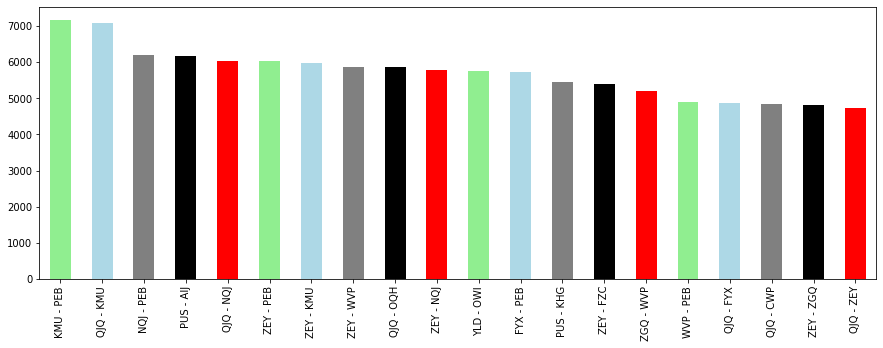

In [11]:
df1[df1['Tanker_gal'] > 0]['pairs'].value_counts().head(20).plot(kind = 'bar', colors = ['lightgreen','lightblue','grey','black','red'], figsize = (15,5))

In [12]:
df1['ACFT'].value_counts()

73W    2474416
73H     742611
7M8      40594
Name: ACFT, dtype: int64

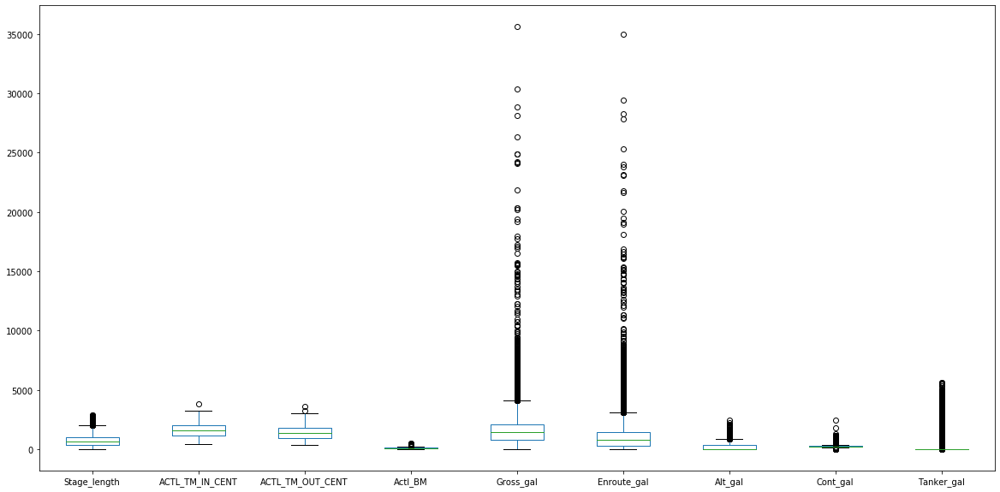

In [13]:
ax = df1.plot.box(['ACFT','Gross_gal'], figsize = (20,10))

In [14]:
def year_month(value):
    value = str(value)
    return str(value[:7])

df1['year_month'] = df1['Dep_dt'].map(year_month)

In [15]:
import datetime

def date_format(value):
    value = str(value)
    year = int(value[:4])
    month = int(value[5:7])
    day = int(value[8:])
    
    #print(year,month,day)
    date = datetime.date(year,month, day)
    return date 


df1['Dep_dt'] = df1['Dep_dt'].map(date_format)
#df1.plot(df1['Dep_dt'], df1['Gross_gal'])


/opt/anaconda3/lib/python3.7/site-packages/pandas/plotting/_matplotlib/core.py:203: UserWarning:

'colors' is being deprecated. Please use 'color'instead of 'colors'



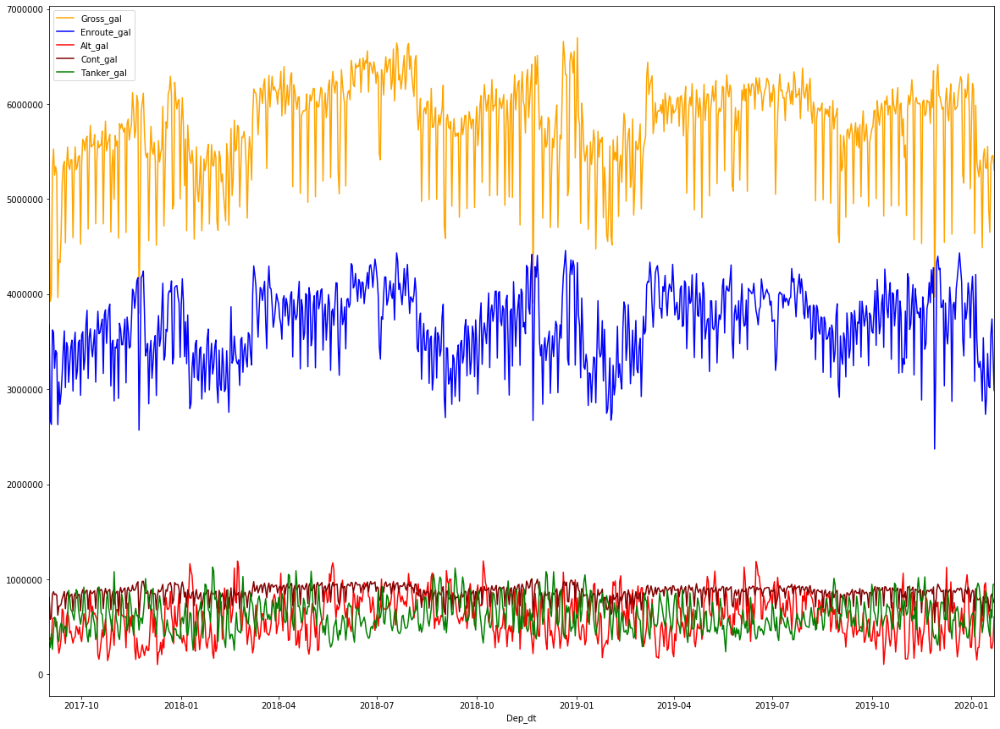

In [16]:
df1.groupby('Dep_dt').sum().plot(y = ['Gross_gal','Enroute_gal','Alt_gal','Cont_gal','Tanker_gal'], figsize = (20,15), colors = ['orange','blue','red','maroon','green'])



In [17]:
a_list = df1['pairs'].value_counts().index[:51]
def top_stations(value): 
    if value in a_list: 
        return 1 
    return 0 

df1['top_50'] = df1['pairs'].map(top_stations)
top_sta = df1[df1['top_50'] == 1]

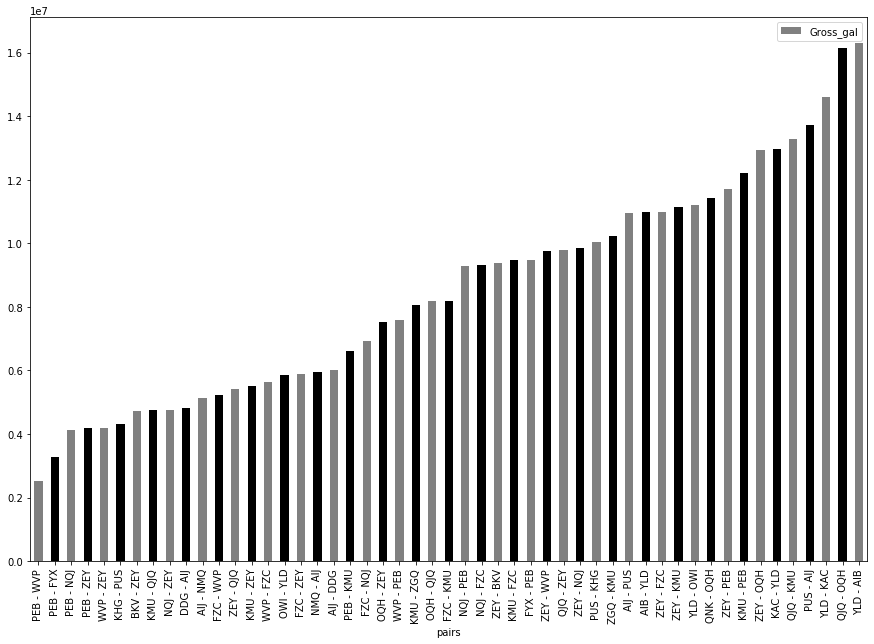

In [18]:
top_sta.groupby('pairs').sum().sort_values(by = 'Gross_gal').plot(kind = 'bar',y = 'Gross_gal', figsize = (15,10), colors = ['grey','black'])



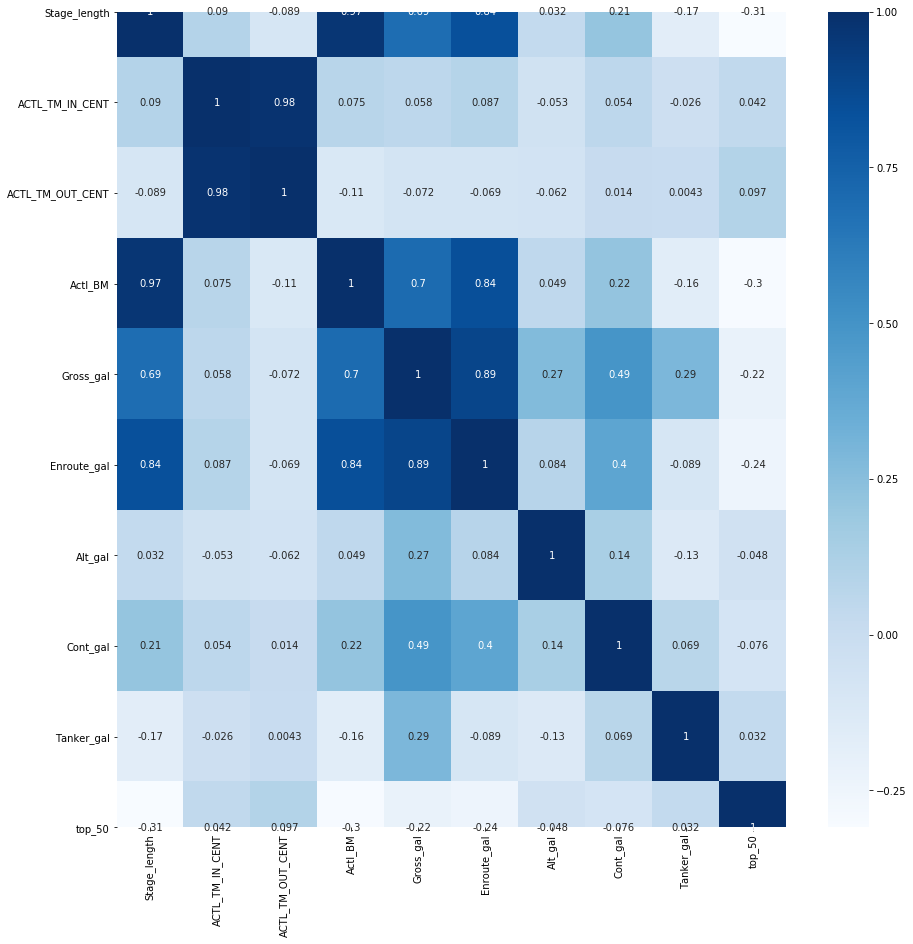

In [19]:


import seaborn as sns
import matplotlib.pyplot as plt
corr = df1.corr()

# plot the heatmap
fig, ax = plt.subplots(figsize=(15,15)) 
sns.heatmap(corr, 
        xticklabels=corr.columns,
        yticklabels=corr.columns,cmap = "Blues", annot = True)

In [20]:
def hour_of_the_day(time):
    time = str(time)
    return int(time[:-2])

df1['hour_out'] = df1['ACTL_TM_OUT_CENT'].map(hour_of_the_day)
df1['hour_in'] = df1['ACTL_TM_IN_CENT'].map(hour_of_the_day)

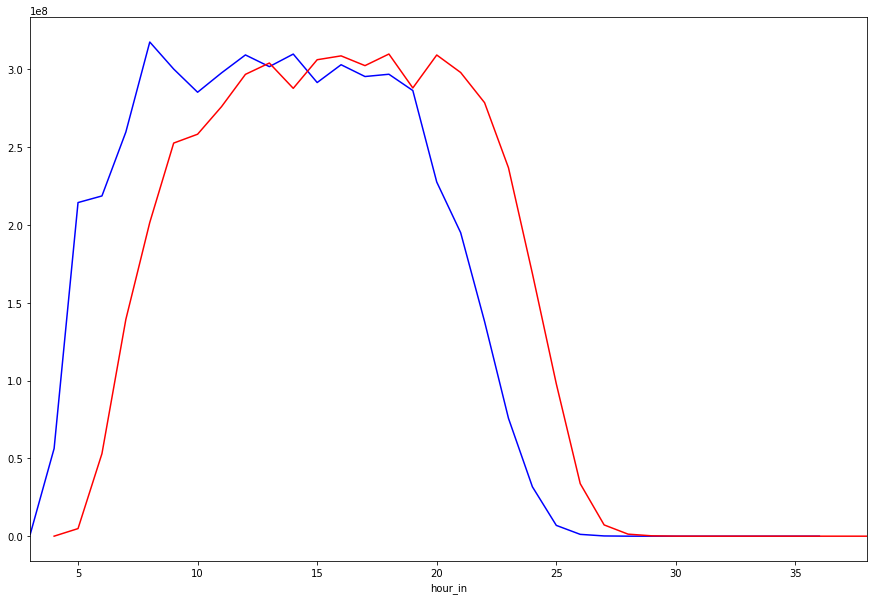

In [21]:
fig, ax = plt.subplots(figsize=(15,10)) 
df1.groupby('hour_out').sum()['Gross_gal'].plot(color = ['blue'])
df1.groupby('hour_in').sum()['Gross_gal'].plot(color = ['r'])

In [87]:
print('There are',len(df1['Tail'].value_counts()),'tail numbers present in the dataset.')

There are 754 tail numbers present in the dataset.


In [43]:
df1[df1['hour_in'] > 24]

,Dep_dt,Orig,Dest,Tail,Stage_length,ACTL_TM_IN_CENT,ACTL_TM_OUT_CENT,ACFT,Actl_BM,Gross_gal,Enroute_gal,Alt_gal,Cont_gal,Tanker_gal,pairs,year_month,top_50,hour_out,hour_in
75,2017-09-15,OQH,FTD,N09303,1056,2524,2252,73W,152,1646.9,1389,0.0,258.4,0.0,OQH - FTD,2017-09,0,22,25
230,2017-10-10,QNK,FZC,N09303,1963,2633,2205,73W,268,3156.6,2630,232.2,294.1,0.0,QNK - FZC,2017-10,0,22,26
262,2017-10-16,QJQ,OQH,N09303,641,2551,2417,73W,94,2218.4,913,0.0,330.1,974.8,QJQ - OQH,2017-10,1,24,25
275,2017-10-18,PEB,PDT,N09303,742,2501,2303,73W,118,1731.8,943,450.9,338.2,0.0,PEB - PDT,2017-10,0,23,25
290,2017-10-20,PEB,FTD,N09303,605,2516,2330,73W,106,2054.9,1288,483.6,283.5,0.0,PEB - FTD,2017-10,0,23,25
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3257445,2019-12-23,PDT,PEB,N92669,742,2606,2407,73W,119,1653.7,690,0.0,225.9,737.9,PDT - PEB,2019-12,0,24,26
3257499,2020-01-01,FZC,BUX,N92669,946,2549,2342,73W,127,220.4,43,0.0,177.6,0.0,FZC - BUX,2020-01,0,23,25
3257507,2020-01-02,QJQ,EVE,N92669,1358,2552,2254,73W,178,2860.9,2035,592.4,233.9,0.0,QJQ - EVE,2020-01,0,22,25
3257546,2020-01-09,QJQ,OQH,N92669,641,2539,2358,73W,101,1952.4,836,697.5,232.5,186.0,QJQ - OQH,2020-01,1,23,25


In [47]:
df1['Gross_gal'].iloc[0]

536.3

# Feature Engineering

In [88]:
df1.head()

,Dep_dt,Orig,Dest,Tail,Stage_length,ACTL_TM_IN_CENT,ACTL_TM_OUT_CENT,ACFT,Actl_BM,Gross_gal,Enroute_gal,Alt_gal,Cont_gal,Tanker_gal,year_month,pairs,top_50,hour_out,hour_in
0,2017-09-01,FYX,ZEY,N09303,240,1005,844,73W,81,536.3,265,0.0,271.4,0.0,2017-09,FYX - ZEY,0,8,10
1,2017-09-01,ZEY,KMU,N09303,274,1139,1043,73W,56,1145.6,495,378.2,272.4,0.0,2017-09,ZEY - KMU,1,10,11
2,2017-09-01,KMU,DWF,N09303,1419,1520,1221,73W,179,1923.3,1695,0.0,228.3,0.0,2017-09,KMU - DWF,0,12,15
3,2017-09-01,DWF,ZEY,N09303,1213,1838,1556,73W,162,2115.7,1883,0.0,233.1,0.0,2017-09,DWF - ZEY,0,15,18
4,2017-09-01,ZEY,FSG,N09303,1051,2140,1925,73W,135,2703.5,1432,0.0,241.4,1029.7,2017-09,ZEY - FSG,0,19,21


In [91]:
df3 = df1.pivot_table(index = ['Orig','year_month'], aggfunc = sum)

In [103]:
df3.iloc[0]

ACTL_TM_IN_CENT     3468097.0
ACTL_TM_OUT_CENT    2924502.0
Actl_BM              325195.0
Alt_gal              358237.8
Cont_gal             584802.5
Enroute_gal         2810413.0
Gross_gal           4294595.0
Stage_length        2234991.0
Tanker_gal           541128.6
hour_in               34002.0
hour_out              28542.0
top_50                  189.0
Name: (AIB, 2017-09), dtype: float64

In [51]:
def month(value): 
    return value[-2:]

df1['month'] = df1['year_month'].map(month)

In [106]:
df1_arima = pd.pivot_table(df1,index = 'Orig', columns = ['year_month'], aggfunc = sum, values = ['Gross_gal'])

In [107]:

sorted(df1[df1['Orig'] == 'API']['Dep_dt'])

[datetime.date(2018, 4, 26), datetime.date(2019, 12, 20)]

In [108]:
from datetime import datetime as dt
df1['day_of_week'] = df1['Dep_dt'].apply(lambda x: dt.weekday(x))

In [109]:
df1.columns

Index(['Dep_dt', 'Orig', 'Dest', 'Tail', 'Stage_length', 'ACTL_TM_IN_CENT',
       'ACTL_TM_OUT_CENT', 'ACFT', 'Actl_BM', 'Gross_gal', 'Enroute_gal',
       'Alt_gal', 'Cont_gal', 'Tanker_gal', 'pairs', 'year_month', 'top_50',
       'hour_out', 'hour_in', 'month', 'day_of_week'],
      dtype='object')

In [110]:
b = df1.groupby(['Orig']).sum()

In [111]:
columns_list = [ 'Actl_BM', 'Gross_gal', 'Enroute_gal',
       'Alt_gal', 'Cont_gal', 'Tanker_gal']

for x in columns_list: 
    df1_arima[x] = b[x]

In [113]:
df1_arima.to_csv('/Users/Aifaz/Desktop/df1_arima.csv')